In [1]:
import pandas as pd
import numpy as np
import librosa
import librosa.display
from matplotlib.pyplot import specgram
import matplotlib.pyplot as plt
import pickle
import gzip
%matplotlib inline

# Reading dataset

In [2]:
with gzip.open('../cache/dataset.pkl.gz', 'rb') as f:
    X, y = pickle.load(f)

In [3]:
a = [x for x, y_ in zip(X, y) if y_ == 0]
b = [x for x, y_ in zip(X, y) if y_ == 1]
c = [x for x, y_ in zip(X, y) if y_ == 2]

## Length problem

In [4]:
len(a), len(b), len(c)

(317, 85, 405)

In [5]:
a_lens = [len(x) for x in a]
b_lens = [len(x) for x in b]
c_lens = [len(x) for x in c]

## Making "c" class data 

In [6]:
m = np.mean(a_lens + b_lens)
s = np.std(a_lens + b_lens)

In [7]:
m, s

(6372.5572139303486, 2354.9324710581363)

In [8]:
len(c)

405

In [9]:
m - s

4017.6247428722122

In [10]:
c_fixed = []
for d in c:
    i = 0
    while i < len(d) - (m - s):
        next_slice = int(i + np.random.randn() * s + m)
        if next_slice < len(d):
            c_fixed.append(d[i:next_slice])
            i = next_slice
        else:
            break

In [11]:
len(c_fixed)

8406

In [12]:
c_fixed_lens = [len(x) for x in c_fixed]

We need to drop some outliers

In [13]:
c_fixed = [d for d in c_fixed if len(d) > 2000 and len(d) < 18000]

In [14]:
len(c_fixed)

8145

In [15]:
from IPython.display import Audio, display

In [16]:
wid = Audio(c_fixed[11], rate=22050)

In [17]:
display(wid)

# New dataset

In [18]:
import random

In [19]:
c_ = np.random.choice(c_fixed, len(a) + len(b), False).tolist()

In [20]:
X = a + b + c_
y = [0] * len(a) + [1] * len(b) + [2] * len(c_)

In [21]:
temp = list(zip(X, y))
random.shuffle(temp)
X, y = zip(*temp)

In [22]:
len(X), len(y)

(804, 804)

# Features

In [23]:
def extract_feature(x):
    features = {}
    stft = np.abs(librosa.stft(x))
    features['stft_min'] = stft.min()
    features['stft_max'] = stft.max()
    features['stft_mean'] = stft.mean()
    features['stft_std'] = stft.std()
    
    mfccs = np.mean(librosa.feature.mfcc(a[1], n_mfcc=5).T, axis=0)
    features['mfccs_0'] = mfccs[0]
    features['mfccs_1'] = mfccs[1]
    features['mfccs_2'] = mfccs[2]
    features['mfccs_3'] = mfccs[3]
    features['mfccs_4'] = mfccs[4]

    chrome = librosa.feature.chroma_stft(S=stft)
    features['chrome_min'] = chrome.min()
    features['chrome_max'] = chrome.max()
    features['chrome_mean'] = chrome.mean()
    features['chrome_std'] = chrome.std()
    
    mel = librosa.feature.melspectrogram(x)
    features['mel_min'] = mel.min()
    features['mel_max'] = mel.max()
    features['mel_mean'] = mel.mean()
    features['mel_std'] = mel.std()
    
    contrast = librosa.feature.spectral_contrast(x)
    features['contrast_min'] = contrast.min()
    features['contrast_max'] = contrast.max()
    features['contrast_mean'] = contrast.mean()
    features['contrast_std'] = contrast.std()
    
    tonnetz = librosa.feature.tonnetz(y=librosa.effects.harmonic(x))
    features['tonnetz_min'] = tonnetz.min()
    features['tonnetz_max'] = tonnetz.max()
    features['tonnetz_mean'] = tonnetz.mean()
    features['tonnetz_std'] = tonnetz.std()
    return features

In [24]:
X_df = pd.DataFrame([extract_feature(x) for x in X])

/home/evgeny/miniconda3/lib/python3.6/site-packages/librosa/core/pitch.py:145: UserWarning: Trying to estimate tuning from empty frequency set.
  warnings.warn('Trying to estimate tuning from empty frequency set.')


In [25]:
X_df.shape

(804, 25)

In [27]:
from pandas_profiling import ProfileReport

In [28]:
rep = ProfileReport(X_df)

In [29]:
rep.get_rejected_variables()

['mel_std', 'mfccs_1', 'mfccs_3', 'mfccs_4', 'stft_std']

In [30]:
X_df = X_df[X_df.columns[X_df.columns.isin(set(X_df.columns) -\
                                           set(rep.get_rejected_variables()))]]

## Models 

In [31]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

In [41]:
model = LGBMClassifier(n_estimators=20)

In [42]:
score = cross_val_score(model, X_df, y, cv=5)

/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/basic.py:642: UserWarning: max_bin keyword has been found in `params` and will be ignored. Please use max_bin argument of the Dataset constructor to pass this parameter.
  'Please use {0} argument of the Dataset constructor to pass this parameter.'.format(key))
/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/basic.py:648: LGBMDeprecationWarning: The `max_bin` parameter is deprecated and will be removed in 2.0.12 version. Please use `params` to pass this parameter.
  'Please use `params` to pass this parameter.', LGBMDeprecationWarning)
/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/basic.py:642: UserWarning: max_bin keyword has been found in `params` and will be ignored. Please use max_bin argument of the Dataset constructor to pass this parameter.
  'Please use {0} argument of the Dataset constructor to pass this parameter.'.format(key))
/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/

In [43]:
score.mean()

0.77486111111111111

In [44]:
X_train, X_test, y_train, y_test = train_test_split(X_df, y, test_size=0.2)

In [45]:
X_train.shape, X_test.shape

((643, 20), (161, 20))

In [46]:
model.fit(X_train, y_train)

/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/basic.py:642: UserWarning: max_bin keyword has been found in `params` and will be ignored. Please use max_bin argument of the Dataset constructor to pass this parameter.
  'Please use {0} argument of the Dataset constructor to pass this parameter.'.format(key))
/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/basic.py:648: LGBMDeprecationWarning: The `max_bin` parameter is deprecated and will be removed in 2.0.12 version. Please use `params` to pass this parameter.
  'Please use `params` to pass this parameter.', LGBMDeprecationWarning)


LGBMClassifier(boosting_type='gbdt', colsample_bytree=1.0, learning_rate=0.1,
        max_bin=255, max_depth=-1, min_child_samples=20,
        min_child_weight=0.001, min_split_gain=0.0, n_estimators=20,
        n_jobs=-1, num_leaves=31, objective=None, random_state=None,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
        subsample_for_bin=200000, subsample_freq=1)

In [47]:
pr = model.predict(X_test)

In [48]:
accuracy_score(y_test, pr)

0.70807453416149069

In [49]:
cm = confusion_matrix(y_test, pr)

In [50]:
cm

array([[46,  1,  9],
       [12,  2,  9],
       [12,  4, 66]])

In [51]:
sorted(zip(X_df.columns, model.feature_importance()), key=lambda x: -x[1])

/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/sklearn.py:588: LGBMDeprecationWarning: The `feature_importance()` method is deprecated and will be removed in 2.0.12 version. Please use attribute `feature_importances_` instead.
  'Please use attribute `feature_importances_` instead.', LGBMDeprecationWarning)


[('chrome_mean', 178),
 ('contrast_mean', 175),
 ('tonnetz_std', 145),
 ('mel_mean', 126),
 ('contrast_max', 105),
 ('tonnetz_mean', 95),
 ('chrome_min', 83),
 ('chrome_std', 78),
 ('mel_max', 71),
 ('tonnetz_min', 64),
 ('tonnetz_max', 63),
 ('mel_min', 58),
 ('contrast_min', 57),
 ('contrast_std', 54),
 ('stft_max', 53),
 ('stft_min', 34),
 ('stft_mean', 19),
 ('chrome_max', 0),
 ('mfccs_0', 0),
 ('mfccs_2', 0)]

In [54]:
accuracy_score(y_test, [2] * len(y_test))

0.50931677018633537

# New audio

In [80]:
model.fit(X_df, y);

/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/basic.py:642: UserWarning: max_bin keyword has been found in `params` and will be ignored. Please use max_bin argument of the Dataset constructor to pass this parameter.
  'Please use {0} argument of the Dataset constructor to pass this parameter.'.format(key))
/home/evgeny/miniconda3/lib/python3.6/site-packages/lightgbm/basic.py:648: LGBMDeprecationWarning: The `max_bin` parameter is deprecated and will be removed in 2.0.12 version. Please use `params` to pass this parameter.
  'Please use `params` to pass this parameter.', LGBMDeprecationWarning)


In [60]:
def get_praat_annotations(paths):
    dfs = []
    for path in paths:
        with open(path) as f:
            annotation = [l.strip() for l in f.readlines()]
            
        indxs = [i for i, l in enumerate(annotation) if l == '"IntervalTier"']
        annotation = annotation[indxs[0] + 5:indxs[1] if len(indxs) > 1\
                                else len(annotation)]
        annotation_dicts = []

        for s, e, l in zip(annotation[0::3], annotation[1::3], annotation[2::3]):
            annotation_dicts.append({
                'start': float(s),
                'finish': float(e),
                'label': l.replace('"', ''),
                'length': float(e) - float(s)
            })
        df = pd.DataFrame(annotation_dicts)
        dfs.append(df)
    return dfs

In [61]:
test_annotation = get_praat_annotations(['../annotations/arhis1.TextGrid'])

In [64]:
test_annotation[0].head()

,finish,label,length,start
0,2.732907,,2.732907,0.000000
1,3.115348,a,0.382441,2.732907
2,5.973958,,2.858611,3.115348
3,6.532115,a,0.558156,5.973958
4,7.963683,,1.431568,6.532115


In [66]:
test_audio, sr = librosa.load('../audio/arhis1.m4a')

In [67]:
len(test_audio), sr

(6994400, 22050)

In [119]:
interval_time = 0.2
interval_step = 0.05

In [224]:
interval, step = librosa.time_to_samples(interval_time)[0],\
                 librosa.time_to_samples(interval_step)[0]

In [225]:
interval, step

(4410, 1102)

Будем нарезать сеплы длины 4000(0.2сек), с шагом в 1000

In [226]:
len(test_audio) / step

6347.0054446460981

In [227]:
test_samples = [test_audio[i * step : i * step + interval] for i in \
                range(len(test_audio) // step - 5)]

In [228]:
len(test_samples)

6342

In [229]:
test_intervals = [(i * step, i * step + interval) for i in\
                  range(len(test_audio) // step - 5)]
test_intervals[-10:]

[(6977864, 6982274),
 (6978966, 6983376),
 (6980068, 6984478),
 (6981170, 6985580),
 (6982272, 6986682),
 (6983374, 6987784),
 (6984476, 6988886),
 (6985578, 6989988),
 (6986680, 6991090),
 (6987782, 6992192)]

In [113]:
test_samples_features = [extract_feature(x) for x in test_samples]

/home/evgeny/miniconda3/lib/python3.6/site-packages/librosa/core/pitch.py:145: UserWarning: Trying to estimate tuning from empty frequency set.
  warnings.warn('Trying to estimate tuning from empty frequency set.')


In [114]:
test_samples_features = pd.DataFrame(test_samples_features)[X_df.columns]

In [115]:
test_samples_pred = model.predict(test_samples_features)

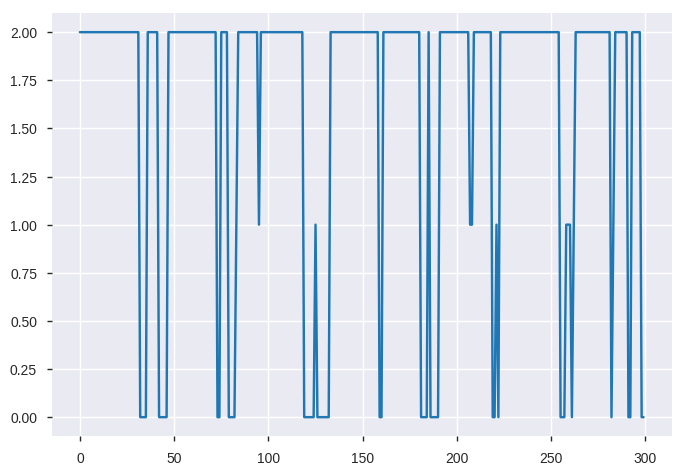

In [116]:
plt.plot(test_samples_pred[:300])

Сейчас предсказаний в 4 раза больше чем интервалов на таймлайне, потому что мы делали их с перекрытием. Теперь нужно их как то сагрегировать, чтобы получить предсказания для каждого интервала длинной 1000. По идее каждый такой интервал будут включать 4 интервала длинной 4000, для которых были предикшны. Два способа:
- Интервалы длинной 4000 как бы сжимаем вправо и влево до интервала длинной 1000
- Бьем таймлайн на интервалы(корзины) по 1000, и расскидываем предикшны по корзинам, в каждую попадет 4 предикта(кроме первой), затем берем наиболее частое предсказание

## Первый способ

In [230]:
result1 = [(t[0] + 2 * step, p) for t, p in zip(test_intervals, test_samples_pred)]

In [232]:
result1 = pd.Series(index=[r[0] for r in result1], data=[r[1] for r in result1])

In [233]:
result1[:5]

2204    2
3306    2
4408    2
5510    2
6612    2
dtype: int64

## Второй

In [284]:
result2 = pd.Series(index=[t[0] + 2 * step for t in test_intervals], data='')

In [285]:
# начинаем с 3000, потому что у кого есть 4 предикшна начинаются с него 
# (с 0 до 4000, c 1000 до 5000, с 2000 до 6000, с 3000 до 7000)
result2.iloc[0] = '2'
for i in range(1, test_samples_pred.shape[0] - 2): 
    for j in range(-1, 3):
#         print(sresult2.iloc[i])
        result2.iloc[i] += str(test_samples_pred[i + j])
result2.iloc[-2] = '2'
result2.iloc[-1] = '2'

In [286]:
from collections import Counter

In [287]:
Counter('2211').most_common()

[('2', 2), ('1', 2)]

In [288]:
def choose(x):
    if len(x) == 1:
        return int(x)
    c = Counter(x).most_common()
    if len(c) == 1:
        return int(c[0][0])
    if c[0][1] != c[1][1]:
        return int(c[0][0])
    else:
        return 2

In [289]:
result2 = result2.apply(choose)

## Оценка качества

Разобьем таймлайн на интервалы и проверим каждый интервал - какой класс занимает большую его часть. Интервал будем кодировать его центральной точкой. Потом сравним два способо описанных выше по качество с помощью точности угадывания класса для каждого интервала

In [269]:
test_annotation[0].head()

,finish,label,length,start
0,2.732907,,2.732907,0.000000
1,3.115348,a,0.382441,2.732907
2,5.973958,,2.858611,3.115348
3,6.532115,a,0.558156,5.973958
4,7.963683,,1.431568,6.532115


In [180]:
librosa.samples_to_time(step // 2) # макс-я погрешность при переводе времени в интервалы

array([ 0.02498866])

In [274]:
y_true = pd.Series(index=result1.index, data=2)

In [276]:
for i in range(0, test_annotation[0].shape[0]):
    l = test_annotation[0].iloc[i].label
    if l in ['a', 'b']:
        s = librosa.time_to_samples(test_annotation[0].iloc[i].start)
        f = librosa.time_to_samples(test_annotation[0].iloc[i].finish)
        s = int(np.round(s / step)) * step
        f = int(np.round(f / step)) * step
        y_true[(y_true.index >= s) & (y_true.index <= f)] = 0 if l == 'a' else 1
#         print(s, f)
#         break

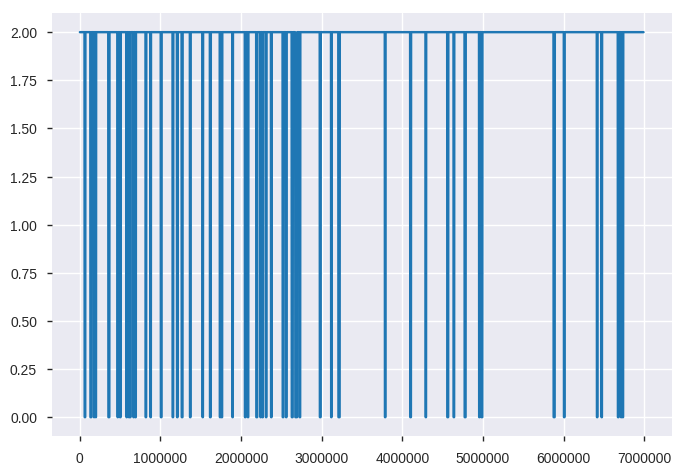

In [277]:
y_true.plot()

In [278]:
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix

In [279]:
accuracy_score(y_true, result1)

0.80290129296751811

In [290]:
accuracy_score(y_true, result2)

0.84500157678965626

In [281]:
accuracy_score(y_true, [2] * len(y_true))

0.92872910753705451

In [282]:
print(classification_report(y_true, result1))

             precision    recall  f1-score   support

          0       0.17      0.37      0.24       452
          1       0.00      0.00      0.00         0
          2       0.95      0.84      0.89      5890

avg / total       0.89      0.80      0.84      6342



/home/evgeny/miniconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1137: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


In [291]:
print(classification_report(y_true, result2))

             precision    recall  f1-score   support

          0       0.18      0.29      0.22       452
          1       0.00      0.00      0.00         0
          2       0.94      0.89      0.91      5890

avg / total       0.89      0.85      0.86      6342



/home/evgeny/miniconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1137: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


# Отображение результата

Получили предикт для каждого интервала, далее превратим это все в видео. Предикт закодируем цветом и наложим звук. Все это через ffmpeg

In [98]:
from IPython.display import Audio, display

In [99]:
wid = Audio(test_audio, rate=22050)

In [101]:
display(wid)